In [1]:
from imagededup.methods import CNN
from imagededup.utils import plot_duplicates

extract_to_folder = '/home/teji/SEM-6/DL/PROJECT/Imagedudep/Test_Images'


# Step 2: Find duplicates using CNN (which uses cosine similarity under the hood)
cnn_encoder = CNN()
duplicates = cnn_encoder.find_duplicates(image_dir=extract_to_folder, min_similarity_threshold=0.5, scores=True)

# If you want to visually inspect duplicates, you can plot them (this is optional)
# This requires matplotlib to be installed and works well in Jupyter notebooks or local Python scripts with GUI capabilities.
# for key in duplicates.keys():
#     plot_duplicates(image_dir=extract_to_folder, duplicate_map=duplicates, filename=key)

# Print out the results
print(duplicates)


2024-04-01 22:07:36,347: INFO Device set to cuda ..
2024-04-01 22:07:36,490: INFO Initialized: mobilenet_v3_small for feature extraction ..
2024-04-01 22:07:36,491: INFO Start: Image encoding generation
2024-04-01 22:07:37,164: INFO End: Image encoding generation
2024-04-01 22:07:37,166: INFO Start: Calculating cosine similarities...
2024-04-01 22:07:37,167: INFO End: Calculating cosine similarities.


{'Noyo1.jpeg': [('Noyo2.jpeg', 0.726791), ('Pt1.jpeg', 0.5872768), ('Pt2.jpeg', 0.5400061), ('Sura2.jpeg', 0.69034445), ('Sura3.jpeg', 0.6654546), ('Sura4.jpeg', 0.570519), ('Tj1.jpeg', 0.67200756), ('Tj2.jpeg', 0.67295325), ('Tj3.jpeg', 0.72811735), ('Tj4.jpeg', 0.59908533), ('Tj5.jpeg', 0.64778256), ('comb1.jpeg', 0.5796263), ('comb2.jpeg', 0.5742887), ('sura1.jpeg', 0.64539146)], 'Noyo2.jpeg': [('Noyo1.jpeg', 0.726791), ('Pt1.jpeg', 0.523422), ('Pt2.jpeg', 0.50517887), ('Sura2.jpeg', 0.638837), ('Sura3.jpeg', 0.6275042), ('Tj1.jpeg', 0.61403227), ('Tj2.jpeg', 0.61581755), ('Tj3.jpeg', 0.6163131), ('Tj4.jpeg', 0.61877215), ('Tj5.jpeg', 0.62336695), ('comb1.jpeg', 0.5919138), ('comb2.jpeg', 0.6034917), ('sura1.jpeg', 0.5604539)], 'Pt1.jpeg': [('Noyo1.jpeg', 0.5872768), ('Noyo2.jpeg', 0.523422), ('Pt2.jpeg', 0.7353115), ('Sura2.jpeg', 0.70833987), ('Sura3.jpeg', 0.6208719), ('Sura4.jpeg', 0.6776138), ('Tj1.jpeg', 0.6250545), ('Tj2.jpeg', 0.67866874), ('Tj3.jpeg', 0.7115378), ('Tj4.jpeg

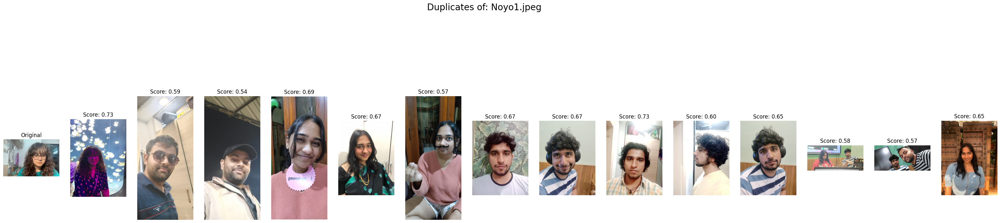

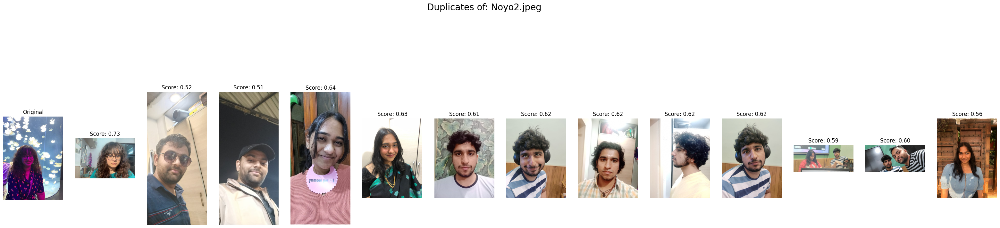

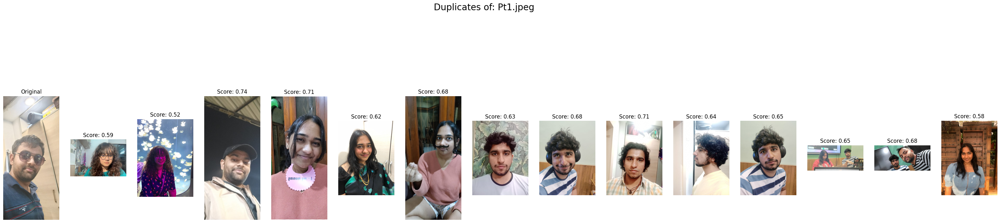

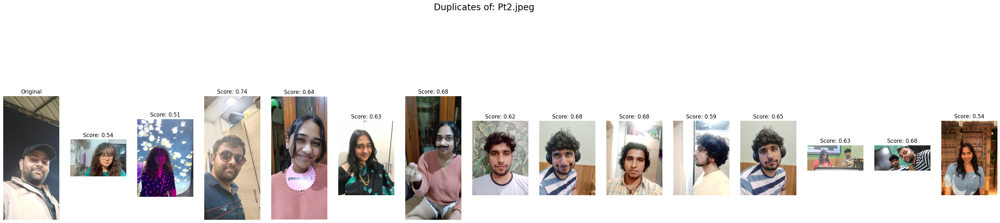

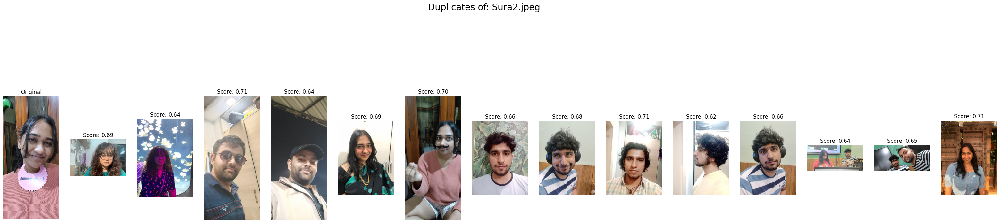

...

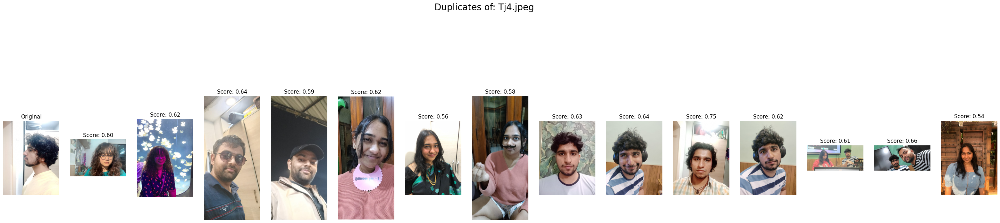

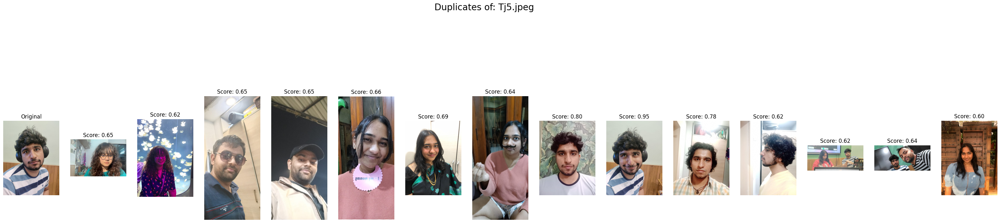

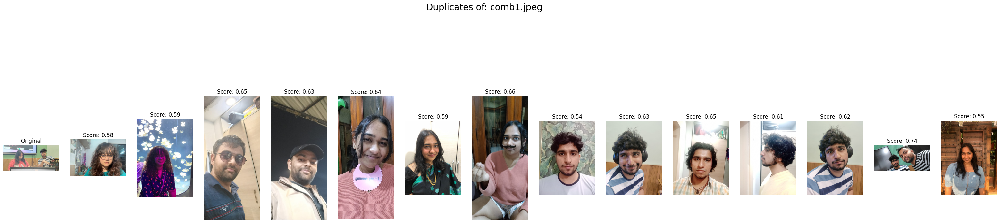

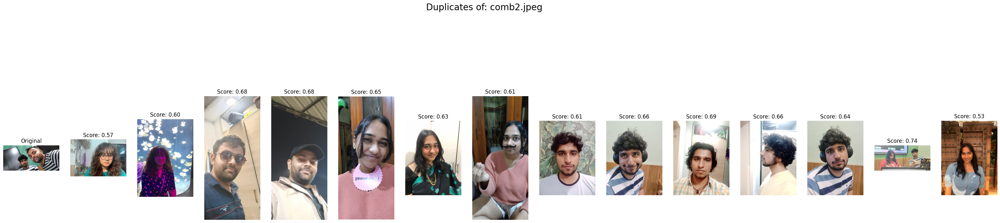

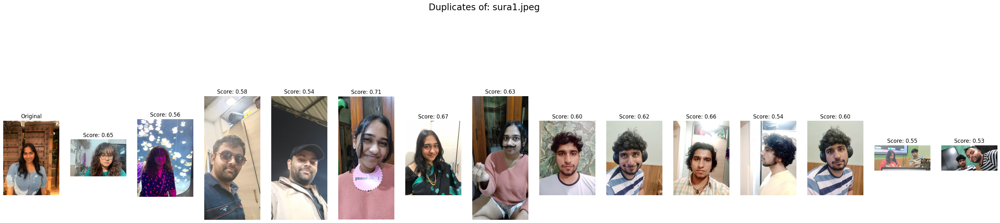

In [2]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
def plot_similar_images(duplicates, image_dir, similarity_threshold):
    for key, values in duplicates.items():
        similar_images = [item for item in values if item[1] >= similarity_threshold]
        if not similar_images:
            continue  # Skip if no duplicates above threshold
        
        # Plot the original image
        plt.figure(figsize=(40, 10))
        plt.suptitle(f'Duplicates of: {key}', fontsize=20)
        
        # Load original image
        img_path = os.path.join(image_dir, key)
        img = mpimg.imread(img_path)
        plt.subplot(1, len(similar_images) + 1, 1)
        plt.imshow(img)
        plt.title('Original')
        plt.axis('off')
        
        # Plot each similar image
        for i, (dup, score) in enumerate(similar_images, start=2):
            img_path = os.path.join(image_dir, dup)
            img = mpimg.imread(img_path)
            plt.subplot(1, len(similar_images) + 1, i)
            plt.imshow(img)
            plt.title(f'Score: {score:.2f}')
            plt.axis('off')
        
        plt.show()

# Assuming 'duplicates' is the dictionary you obtained from the previous step
plot_similar_images(duplicates, extract_to_folder, similarity_threshold=0.5)
